<a href="https://colab.research.google.com/github/Tiagoeem/Ensaio_Sobre_o_AutoML/blob/main/Auto_ML_PyCaret_Customizado_Rain_Aus.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# Para medir o tempo de execução do script
import time
ini = time.time()

# Instalando PyCaret

Instalando módulos para suporte a GPU, treinamento demorou demais nos primeiros testes. [PyCaret on GPU](https://pycaret.readthedocs.io/en/latest/installation.html)

In [2]:
!pip install -U pandas-profiling

     |████████████████████████████████| 256kB 8.5MB/s 
     |████████████████████████████████| 10.1MB 15.1MB/s 
     |████████████████████████████████| 61kB 9.6MB/s 
     |████████████████████████████████| 3.1MB 47.2MB/s 
     |████████████████████████████████| 81kB 9.0MB/s 
     |████████████████████████████████| 1.1MB 40.4MB/s 
     |████████████████████████████████| 645kB 44.1MB/s 
     |████████████████████████████████| 112kB 53.9MB/s 
     |████████████████████████████████| 296kB 50.8MB/s 
  Created wheel for htmlmin: filename=htmlmin-0.1.12-cp37-none-any.whl size=27085 sha256=e2551e54b11e5cc5f0da02e330e0f1cffb0809f25cbe8902d09cdf4026954c7c
  Stored in directory: /root/.cache/pip/wheels/43/07/ac/7c5a9d708d65247ac1f94066cf1db075540b85716c30255459
  Created wheel for phik: filename=phik-0.11.2-cp37-none-any.whl size=1107413 sha256=6b6a472116837d6b5edb45b02bb202ce5837aebb533743369c44e67541ff8cc2
  Stored in directory: /root/.cache/pip/wheels/c0/a3/b0/f27b1cfe32ea131a3715169132ff6d856

In [3]:
!pip install pycaret==2.2.3

     |████████████████████████████████| 256kB 8.0MB/s 
     |████████████████████████████████| 1.7MB 25.6MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
    Preparing wheel metadata ... done
     |████████████████████████████████| 112kB 52.8MB/s 
     |████████████████████████████████| 166.7MB 87kB/s 
     |████████████████████████████████| 2.0MB 46.3MB/s 
     |████████████████████████████████| 276kB 48.1MB/s 
     |████████████████████████████████| 81kB 13.0MB/s 
     |████████████████████████████████| 14.2MB 245kB/s 
     |████████████████████████████████| 67.3MB 42kB/s 
     |████████████████████████████████| 6.8MB 30.7MB/s 
     |████████████████████████████████| 215kB 54.6MB/s 
     |████████████████████████████████| 1.2MB 42.9MB/s 
     |████████████████████████████████| 174kB 54.2MB/s 
     |████████████████████████████████| 1.1MB 30.3MB/s 
     |████████████████████████████████| 61kB 9.6MB

In [4]:
from pycaret.utils import enable_colab
enable_colab()

Colab mode enabled.


# Nota

Este notebook irá testar a performance da biblioteca Pycaret, será testado também a biblioteca H2O.ai em outro notebook ().

# Rain in Australia

Conjutno de dados - Rain in Australia: https://www.kaggle.com/jsphyg/weather-dataset-rattle-package

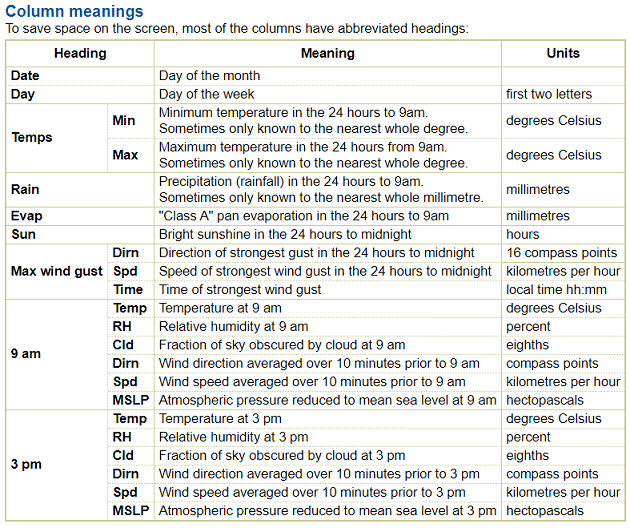

In [5]:
# Baixa o csv a partir de um link para que qualquer pessoa possa executar sem maiores dificuldades
# Uniformiza o trabalho e facilita o compartilhamento de códigos e notebooks
# Realiza o download dos dados e extrai para uma pasta conhecida
import zipfile
import gdown
import os

parent_dir = '/content'

file_name = 'rain_aus.csv'
output = os.path.join( parent_dir, file_name )

if not(os.path.isfile(output)):
    url = 'https://drive.google.com/u/0/uc?id=1eT05yNu1TvSXlcEdrgAGKAx7bdEEMrLl'
    gdown.download(url, output=output, quiet=True)


In [6]:
import pandas as pd

df_rain = pd.read_csv('rain_aus.csv')
df_rain.head(3)

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RISK_MM,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,0.0,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,0.0,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,0.0,No


In [7]:
# Risk_mm é label para regressão, deve ser removido
df_rain.drop(labels='RISK_MM', axis='columns', inplace=True)

In [8]:
df_rain.shape

(142193, 23)

# Análise Exploratória de Dados (*EDA*)

Utilizando o [Pandas Profiling](https://pandas-profiling.github.io/pandas-profiling/docs/master/index.html#pandas-profiling) para um rápido EDA rápido.

In [9]:
from pandas_profiling import ProfileReport

profile = ProfileReport(df_rain)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/36 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Separação de dados

Por padrão o Pycaret separa os dados em Treino e teste (70%, 30%). Mas uma boa pratica é remover de 5% a 10% dos dados para uma validação final após finalização de todo o processo de modelagem e treinamento.

In [10]:
df_validacao_final = df_rain.sample(frac=0.05, random_state=777)
df_rain.drop(df_validacao_final.index, inplace=True)
df_rain.reset_index(inplace=True, drop=True)

In [11]:
print(df_rain.shape)
print(df_validacao_final.shape)

(135083, 23)
(7110, 23)


# Pycaret com Parâmetros Default

The **setup()** function initializes the environment in pycaret and creates the transformation pipeline to prepare the data for modeling and deployment. **setup()** must be called before executing any other function in pycaret. [Retirado do github oficial do PyCaret](https://github.com/pycaret/pycaret/blob/master/tutorials/Binary%20Classification%20Tutorial%20Level%20Beginner%20-%20%20CLF101.ipynb)

In [12]:
from pycaret.classification import *

clf_default = setup(df_rain, target = 'RainTomorrow', session_id=1, use_gpu=True, experiment_name='Pycaret Default Config - Rain',
                    normalize = True, 
                    transformation = True, 
                    ignore_low_variance = True,
                    group_features = [['WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm'],
                                   ['Humidity9am','Humidity3pm'], ['Pressure9am', 'Pressure3pm'], ['Temp9am', 'Temp3pm']],
                    remove_multicollinearity = True, multicollinearity_threshold = 0.95)

,Description,Value
0,session_id,1
1,Target,RainTomorrow
2,Target Type,Binary
3,Label Encoded,"No: 0, Yes: 1"
4,Original Data,"(135083, 23)"
5,Missing Values,True
6,Numeric Features,14
7,Categorical Features,7
8,Ordinal Features,False
9,High Cardinality Features,False


## Comparando modelos

 
"Comparing all models to evaluate performance is the recommended starting point for modeling once the setup is completed (unless you exactly know what kind of model you need, which is often not the case)." [Retirado do github oficial do PyCaret](https://github.com/pycaret/pycaret/blob/master/tutorials/Binary%20Classification%20Tutorial%20Level%20Beginner%20-%20%20CLF101.ipynb)

In [13]:
best_model = compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
catboost,CatBoost Classifier,0.8574,0.8885,0.5303,0.7603,0.6247,0.5401,0.5536,6.481
xgboost,Extreme Gradient Boosting,0.8572,0.8885,0.5544,0.7425,0.6347,0.5482,0.5573,2.164
lightgbm,Light Gradient Boosting Machine,0.8556,0.8875,0.5373,0.7468,0.6248,0.5384,0.5496,1.708
et,Extra Trees Classifier,0.8524,0.8823,0.4706,0.7839,0.5879,0.5048,0.5293,28.253
rf,Random Forest Classifier,0.8514,0.8803,0.4824,0.7679,0.5923,0.5073,0.5279,19.906
gbc,Gradient Boosting Classifier,0.8490,0.8732,0.4934,0.7463,0.5939,0.5059,0.5223,36.485
lda,Linear Discriminant Analysis,0.8465,0.8687,0.5264,0.7129,0.6055,0.5129,0.5221,3.359
lr,Logistic Regression,0.8462,0.8668,0.5059,0.7238,0.5954,0.5041,0.5165,30.710
ridge,Ridge Classifier,0.8458,0.0000,0.4686,0.7486,0.5763,0.4881,0.5082,0.402
ada,Ada Boost Classifier,0.8417,0.8638,0.4926,0.7121,0.5821,0.4885,0.5012,9.420


In [14]:
print(best_model)

## Criando Modelos Individuais


### Utilizando o best: LGBM

In [15]:
#lightgbm
lightgbm = create_model('lightgbm')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8607,0.8918,0.5531,0.7594,0.6401,0.5564,0.5671
1,0.8497,0.8802,0.5116,0.7367,0.6038,0.5148,0.5279
2,0.8587,0.8928,0.5527,0.7505,0.6366,0.5514,0.5613
3,0.8600,0.8946,0.5461,0.7610,0.6359,0.5521,0.5637
4,0.8531,0.8864,0.5172,0.7490,0.6119,0.5250,0.5387
5,0.8546,0.8865,0.5434,0.7383,0.6261,0.5384,0.5481
6,0.8559,0.8883,0.5382,0.7475,0.6259,0.5395,0.5507
7,0.8549,0.8868,0.5340,0.7460,0.6225,0.5357,0.5472
8,0.8556,0.8870,0.5579,0.7335,0.6338,0.5459,0.5538
9,0.8527,0.8804,0.5191,0.7456,0.6121,0.5247,0.5378


## Tunando os Modelos

By default, tune_model optimizes Accuracy but this can be changed using optimize parameter. For example: tune_model(dt, optimize = 'AUC') will search for the hyperparameters of a Decision Tree Classifier that results in the highest AUC instead of Accuracy. [Retirado do github oficial do PyCaret](https://github.com/pycaret/pycaret/blob/master/tutorials/Binary%20Classification%20Tutorial%20Level%20Beginner%20-%20%20CLF101.ipynb)

### LightGBM

In [16]:
tuned_lgbm = tune_model(lightgbm)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8621,0.8969,0.5853,0.7441,0.6552,0.5706,0.5770
1,0.8553,0.8870,0.5404,0.7433,0.6258,0.5389,0.5494
2,0.8597,0.8977,0.5838,0.7348,0.6507,0.5643,0.5702
3,0.8588,0.8969,0.5711,0.7390,0.6443,0.5580,0.5652
4,0.8538,0.8880,0.5385,0.7379,0.6226,0.5347,0.5449
5,0.8583,0.8916,0.5732,0.7358,0.6444,0.5576,0.5644
6,0.8605,0.8928,0.5595,0.7543,0.6425,0.5582,0.5678
7,0.8590,0.8962,0.5675,0.7424,0.6433,0.5574,0.5652
8,0.8555,0.8938,0.5668,0.7277,0.6373,0.5488,0.5555
9,0.8573,0.8879,0.5555,0.7424,0.6355,0.5491,0.5580


## Validando os modelos (Métricas e Gráficos)


### Melhor modelo

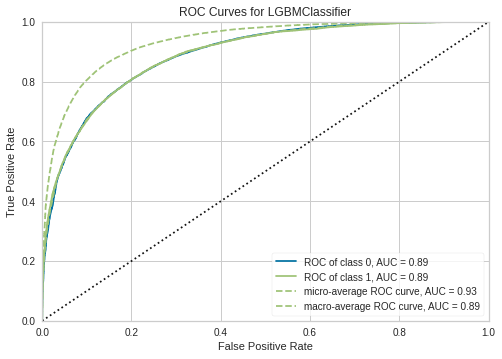

In [17]:
plot_model(tuned_lgbm, plot='auc')

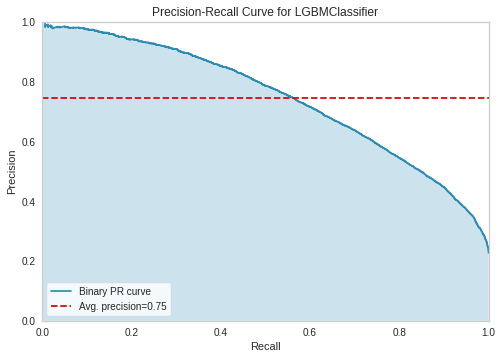

In [18]:
plot_model(tuned_lgbm, plot = 'pr')

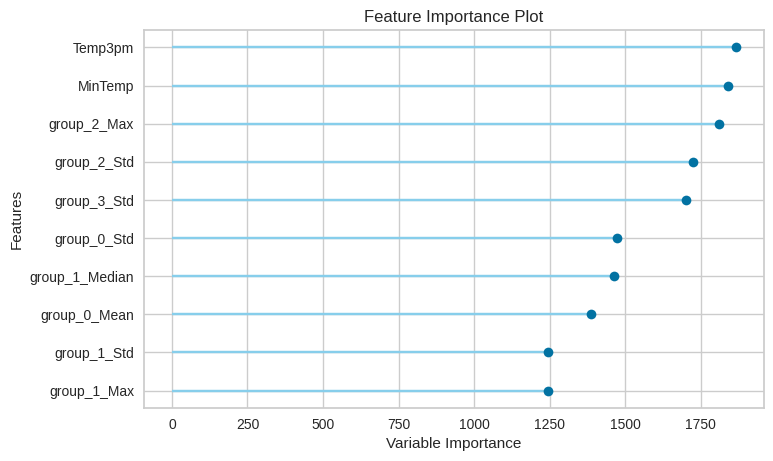

In [19]:
plot_model(tuned_lgbm, plot='feature')

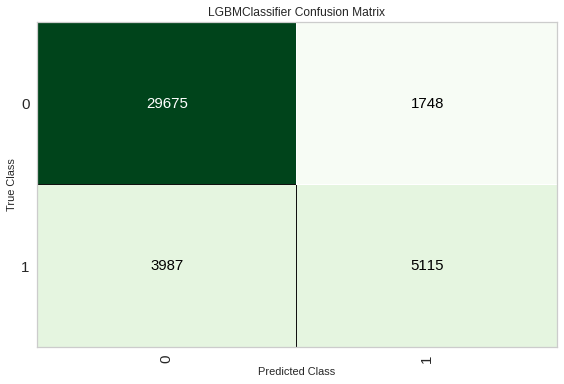

In [20]:
plot_model(tuned_lgbm, plot = 'confusion_matrix')

## Avaliando os conjunto de **Teste**

Before finalizing the model, it is advisable to perform one final check by predicting the test/hold-out set and reviewing the evaluation metrics. [Retirado do github oficial do PyCaret](https://github.com/pycaret/pycaret/blob/master/tutorials/Binary%20Classification%20Tutorial%20Level%20Beginner%20-%20%20CLF101.ipynb)

### LightGBM

In [21]:
predict_model(tuned_lgbm).head()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Light Gradient Boosting Machine,0.8585,0.8899,0.562,0.7453,0.6408,0.5548,0.5634


,MinTemp,Rainfall,Evaporation,WindSpeed9am,WindSpeed3pm,Humidity3pm,Temp3pm,group_0_Min,group_0_Max,group_0_Mean,group_0_Median,group_0_Std,group_1_Max,group_1_Median,group_1_Std,group_2_Max,group_2_Std,group_3_Std,Location_Adelaide,Location_Albany,Location_Albury,Location_AliceSprings,Location_Ballarat,Location_Bendigo,Location_Brisbane,Location_Cairns,Location_Canberra,Location_Cobar,Location_CoffsHarbour,Location_Dartmoor,Location_Darwin,Location_GoldCoast,Location_Hobart,Location_Katherine,Location_Launceston,Location_Melbourne,Location_MelbourneAirport,Location_Mildura,Location_Moree,Location_MountGambier,...,Cloud9am_6.0,Cloud9am_7.0,Cloud9am_8.0,Cloud9am_9.0,Cloud9am_not_available,Cloud3pm_0.0,Cloud3pm_1.0,Cloud3pm_2.0,Cloud3pm_3.0,Cloud3pm_4.0,Cloud3pm_5.0,Cloud3pm_6.0,Cloud3pm_7.0,Cloud3pm_8.0,Cloud3pm_not_available,RainToday_not_available,Date_month_1,Date_month_10,Date_month_11,Date_month_12,Date_month_2,Date_month_3,Date_month_4,Date_month_5,Date_month_6,Date_month_7,Date_month_8,Date_month_9,Date_weekday_0,Date_weekday_1,Date_weekday_2,Date_weekday_3,Date_weekday_4,Date_weekday_5,Date_weekday_6,Date_is_month_end_1,Date_is_month_start_0,RainTomorrow,Label,Score
0,0.091442,2.132440,-0.165976,1.467393,1.526193,-0.018256,-0.486909,28.0,52.0,37.666668,33.0,10.338709,70.0,60.5,9.5,1015.200012,0.050018,1.80,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,No,No,0.9460
1,1.538304,1.095181,0.311972,0.256625,0.267463,0.176370,0.929928,15.0,39.0,24.666666,20.0,10.338708,68.0,61.5,6.5,1016.700012,0.800018,0.55,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,No,No,0.6819
2,0.757711,-0.615305,0.187286,0.771351,-0.612456,-1.097003,1.846817,13.0,61.0,31.333334,20.0,21.171261,54.0,41.5,12.5,1013.200012,1.649994,4.75,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,No,No,0.8554
3,-0.569804,0.691484,-0.165976,0.472760,-0.087114,-1.442357,0.498362,17.0,37.0,23.666666,17.0,9.428090,63.0,42.5,20.5,1019.599976,0.699982,4.65,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,No,No,0.9969
4,-0.665024,1.799474,-1.763220,0.472760,0.485392,0.612530,-0.820025,17.0,35.0,24.666666,22.0,7.586538,64.0,62.5,1.5,1012.200012,0.050018,0.80,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,No,No,0.8278


## Realizando a Calibração dos Modelos

Verificar se existe melhora.

In [22]:
best_calib = calibrate_model(tuned_lgbm)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8644,0.9011,0.5683,0.7658,0.6524,0.5705,0.5803
1,0.8580,0.8914,0.5324,0.7615,0.6266,0.5423,0.5556
2,0.8652,0.9035,0.5772,0.7628,0.6572,0.5752,0.5839
3,0.8672,0.9032,0.5697,0.7776,0.6576,0.5776,0.5884
4,0.8600,0.8955,0.5409,0.7649,0.6336,0.5502,0.5629
5,0.8611,0.8947,0.5652,0.7533,0.6458,0.5616,0.5706
6,0.8617,0.8974,0.5482,0.7679,0.6397,0.5570,0.5691
7,0.8588,0.9004,0.5500,0.7531,0.6357,0.5508,0.5613
8,0.8625,0.8979,0.5668,0.7581,0.6486,0.5654,0.5746
9,0.8610,0.8926,0.5427,0.7686,0.6362,0.5534,0.5662


In [23]:
predict_model(best_calib).head()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Light Gradient Boosting Machine,0.8623,0.895,0.5552,0.7672,0.6442,0.5615,0.5728


,MinTemp,Rainfall,Evaporation,WindSpeed9am,WindSpeed3pm,Humidity3pm,Temp3pm,group_0_Min,group_0_Max,group_0_Mean,group_0_Median,group_0_Std,group_1_Max,group_1_Median,group_1_Std,group_2_Max,group_2_Std,group_3_Std,Location_Adelaide,Location_Albany,Location_Albury,Location_AliceSprings,Location_Ballarat,Location_Bendigo,Location_Brisbane,Location_Cairns,Location_Canberra,Location_Cobar,Location_CoffsHarbour,Location_Dartmoor,Location_Darwin,Location_GoldCoast,Location_Hobart,Location_Katherine,Location_Launceston,Location_Melbourne,Location_MelbourneAirport,Location_Mildura,Location_Moree,Location_MountGambier,...,Cloud9am_6.0,Cloud9am_7.0,Cloud9am_8.0,Cloud9am_9.0,Cloud9am_not_available,Cloud3pm_0.0,Cloud3pm_1.0,Cloud3pm_2.0,Cloud3pm_3.0,Cloud3pm_4.0,Cloud3pm_5.0,Cloud3pm_6.0,Cloud3pm_7.0,Cloud3pm_8.0,Cloud3pm_not_available,RainToday_not_available,Date_month_1,Date_month_10,Date_month_11,Date_month_12,Date_month_2,Date_month_3,Date_month_4,Date_month_5,Date_month_6,Date_month_7,Date_month_8,Date_month_9,Date_weekday_0,Date_weekday_1,Date_weekday_2,Date_weekday_3,Date_weekday_4,Date_weekday_5,Date_weekday_6,Date_is_month_end_1,Date_is_month_start_0,RainTomorrow,Label,Score
0,0.091442,2.132440,-0.165976,1.467393,1.526193,-0.018256,-0.486909,28.0,52.0,37.666668,33.0,10.338709,70.0,60.5,9.5,1015.200012,0.050018,1.80,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,No,No,0.9115
1,1.538304,1.095181,0.311972,0.256625,0.267463,0.176370,0.929928,15.0,39.0,24.666666,20.0,10.338708,68.0,61.5,6.5,1016.700012,0.800018,0.55,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,No,No,0.8425
2,0.757711,-0.615305,0.187286,0.771351,-0.612456,-1.097003,1.846817,13.0,61.0,31.333334,20.0,21.171261,54.0,41.5,12.5,1013.200012,1.649994,4.75,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,No,No,0.8684
3,-0.569804,0.691484,-0.165976,0.472760,-0.087114,-1.442357,0.498362,17.0,37.0,23.666666,17.0,9.428090,63.0,42.5,20.5,1019.599976,0.699982,4.65,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,No,No,0.9459
4,-0.665024,1.799474,-1.763220,0.472760,0.485392,0.612530,-0.820025,17.0,35.0,24.666666,22.0,7.586538,64.0,62.5,1.5,1012.200012,0.050018,0.80,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,No,No,0.8539


### CatBoost

In [33]:
cat = create_model('catboost')
tuned_cat = tune_model(cat)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8496,0.8742,0.4813,0.7587,0.5890,0.5026,0.5221
1,0.8402,0.8593,0.4336,0.7463,0.5486,0.4596,0.4847
2,0.8474,0.8723,0.4705,0.7557,0.5799,0.4928,0.5134
3,0.8481,0.8748,0.4714,0.7589,0.5816,0.4949,0.5159
4,0.8400,0.8636,0.4289,0.7492,0.5455,0.4570,0.4832
5,0.8458,0.8705,0.4726,0.7459,0.5786,0.4900,0.5091
6,0.8471,0.8684,0.4679,0.7565,0.5782,0.4911,0.5122
7,0.8444,0.8649,0.4585,0.7498,0.5690,0.4807,0.5024
8,0.8474,0.8675,0.4809,0.7474,0.5852,0.4971,0.5152
9,0.8438,0.8602,0.4412,0.7606,0.5584,0.4716,0.4974


In [34]:
predict_model(tuned_cat).head()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,CatBoost Classifier,0.8459,0.8653,0.4589,0.7599,0.5722,0.4851,0.5081


,MinTemp,Rainfall,Evaporation,WindSpeed9am,WindSpeed3pm,Humidity3pm,Temp3pm,group_0_Min,group_0_Max,group_0_Mean,group_0_Median,group_0_Std,group_1_Max,group_1_Median,group_1_Std,group_2_Max,group_2_Std,group_3_Std,Location_Adelaide,Location_Albany,Location_Albury,Location_AliceSprings,Location_Ballarat,Location_Bendigo,Location_Brisbane,Location_Cairns,Location_Canberra,Location_Cobar,Location_CoffsHarbour,Location_Dartmoor,Location_Darwin,Location_GoldCoast,Location_Hobart,Location_Katherine,Location_Launceston,Location_Melbourne,Location_MelbourneAirport,Location_Mildura,Location_Moree,Location_MountGambier,...,Cloud9am_6.0,Cloud9am_7.0,Cloud9am_8.0,Cloud9am_9.0,Cloud9am_not_available,Cloud3pm_0.0,Cloud3pm_1.0,Cloud3pm_2.0,Cloud3pm_3.0,Cloud3pm_4.0,Cloud3pm_5.0,Cloud3pm_6.0,Cloud3pm_7.0,Cloud3pm_8.0,Cloud3pm_not_available,RainToday_not_available,Date_month_1,Date_month_10,Date_month_11,Date_month_12,Date_month_2,Date_month_3,Date_month_4,Date_month_5,Date_month_6,Date_month_7,Date_month_8,Date_month_9,Date_weekday_0,Date_weekday_1,Date_weekday_2,Date_weekday_3,Date_weekday_4,Date_weekday_5,Date_weekday_6,Date_is_month_end_1,Date_is_month_start_0,RainTomorrow,Label,Score
0,0.091442,2.132440,-0.165976,1.467393,1.526193,-0.018256,-0.486909,28.0,52.0,37.666668,33.0,10.338709,70.0,60.5,9.5,1015.200012,0.050018,1.80,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,No,No,0.7870
1,1.538304,1.095181,0.311972,0.256625,0.267463,0.176370,0.929928,15.0,39.0,24.666666,20.0,10.338708,68.0,61.5,6.5,1016.700012,0.800018,0.55,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,No,No,0.8160
2,0.757711,-0.615305,0.187286,0.771351,-0.612456,-1.097003,1.846817,13.0,61.0,31.333334,20.0,21.171261,54.0,41.5,12.5,1013.200012,1.649994,4.75,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,No,No,0.8350
3,-0.569804,0.691484,-0.165976,0.472760,-0.087114,-1.442357,0.498362,17.0,37.0,23.666666,17.0,9.428090,63.0,42.5,20.5,1019.599976,0.699982,4.65,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,No,No,0.9564
4,-0.665024,1.799474,-1.763220,0.472760,0.485392,0.612530,-0.820025,17.0,35.0,24.666666,22.0,7.586538,64.0,62.5,1.5,1012.200012,0.050018,0.80,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,No,No,0.6833


## Realizando a Calibração dos Modelos

Verificar se existe melhora.

In [35]:
best_calib_cat = calibrate_model(tuned_cat)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8504,0.8746,0.5139,0.7381,0.6060,0.5172,0.5301
1,0.8421,0.8596,0.4624,0.7339,0.5674,0.4768,0.4958
2,0.8467,0.8726,0.5002,0.7298,0.5936,0.5031,0.5168
3,0.8475,0.8751,0.4936,0.7385,0.5917,0.5025,0.5179
4,0.8421,0.8639,0.4591,0.7364,0.5656,0.4754,0.4952
5,0.8469,0.8704,0.5000,0.7314,0.5939,0.5037,0.5175
6,0.8473,0.8683,0.4934,0.7380,0.5914,0.5020,0.5174
7,0.8473,0.8653,0.4920,0.7390,0.5907,0.5014,0.5171
8,0.8480,0.8675,0.5078,0.7313,0.5994,0.5093,0.5222
9,0.8457,0.8602,0.4771,0.7416,0.5806,0.4915,0.5094


In [36]:
predict_model(best_calib_cat).head()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,CatBoost Classifier,0.8462,0.8653,0.488,0.7384,0.5876,0.4979,0.514


,MinTemp,Rainfall,Evaporation,WindSpeed9am,WindSpeed3pm,Humidity3pm,Temp3pm,group_0_Min,group_0_Max,group_0_Mean,group_0_Median,group_0_Std,group_1_Max,group_1_Median,group_1_Std,group_2_Max,group_2_Std,group_3_Std,Location_Adelaide,Location_Albany,Location_Albury,Location_AliceSprings,Location_Ballarat,Location_Bendigo,Location_Brisbane,Location_Cairns,Location_Canberra,Location_Cobar,Location_CoffsHarbour,Location_Dartmoor,Location_Darwin,Location_GoldCoast,Location_Hobart,Location_Katherine,Location_Launceston,Location_Melbourne,Location_MelbourneAirport,Location_Mildura,Location_Moree,Location_MountGambier,...,Cloud9am_6.0,Cloud9am_7.0,Cloud9am_8.0,Cloud9am_9.0,Cloud9am_not_available,Cloud3pm_0.0,Cloud3pm_1.0,Cloud3pm_2.0,Cloud3pm_3.0,Cloud3pm_4.0,Cloud3pm_5.0,Cloud3pm_6.0,Cloud3pm_7.0,Cloud3pm_8.0,Cloud3pm_not_available,RainToday_not_available,Date_month_1,Date_month_10,Date_month_11,Date_month_12,Date_month_2,Date_month_3,Date_month_4,Date_month_5,Date_month_6,Date_month_7,Date_month_8,Date_month_9,Date_weekday_0,Date_weekday_1,Date_weekday_2,Date_weekday_3,Date_weekday_4,Date_weekday_5,Date_weekday_6,Date_is_month_end_1,Date_is_month_start_0,RainTomorrow,Label,Score
0,0.091442,2.132440,-0.165976,1.467393,1.526193,-0.018256,-0.486909,28.0,52.0,37.666668,33.0,10.338709,70.0,60.5,9.5,1015.200012,0.050018,1.80,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,No,No,0.8364
1,1.538304,1.095181,0.311972,0.256625,0.267463,0.176370,0.929928,15.0,39.0,24.666666,20.0,10.338708,68.0,61.5,6.5,1016.700012,0.800018,0.55,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,No,No,0.8579
2,0.757711,-0.615305,0.187286,0.771351,-0.612456,-1.097003,1.846817,13.0,61.0,31.333334,20.0,21.171261,54.0,41.5,12.5,1013.200012,1.649994,4.75,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,No,No,0.8791
3,-0.569804,0.691484,-0.165976,0.472760,-0.087114,-1.442357,0.498362,17.0,37.0,23.666666,17.0,9.428090,63.0,42.5,20.5,1019.599976,0.699982,4.65,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,No,No,0.9402
4,-0.665024,1.799474,-1.763220,0.472760,0.485392,0.612530,-0.820025,17.0,35.0,24.666666,22.0,7.586538,64.0,62.5,1.5,1012.200012,0.050018,0.80,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,No,No,0.7308


## Finalizando o modelo

Modelo escolhido: LightGBM

The finalize_model() function fits the model onto the complete dataset including the test/hold-out sample (30% in this case). The purpose of this function is to train the model on the complete dataset before it is deployed in production. [Retirado do github oficial do PyCaret](https://github.com/pycaret/pycaret/blob/master/tutorials/Binary%20Classification%20Tutorial%20Level%20Beginner%20-%20%20CLF101.ipynb)

In [24]:
final_model = finalize_model(best_calib)

[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 

In [25]:
print(final_model)

CalibratedClassifierCV(base_estimator=LGBMClassifier(bagging_fraction=0.9,
                                                     bagging_freq=7,
                                                     boosting_type='gbdt',
                                                     class_weight=None,
                                                     colsample_bytree=1.0,
                                                     feature_fraction=0.4,
                                                     importance_type='split',
                                                     learning_rate=0.153,
                                                     max_depth=-1,
                                                     min_child_samples=20,
                                                     min_child_weight=0.001,
                                                     min_split_gain=0,
                                                     n_estimators=210,
                                              

In [26]:
# Visualizando os parametros do modelo que irá para Deploy
final_model.get_params()

{'base_estimator': LGBMClassifier(bagging_fraction=0.9, bagging_freq=7, boosting_type='gbdt',
                class_weight=None, colsample_bytree=1.0, feature_fraction=0.4,
                importance_type='split', learning_rate=0.153, max_depth=-1,
                min_child_samples=20, min_child_weight=0.001, min_split_gain=0,
                n_estimators=210, n_jobs=-1, num_leaves=150, objective=None,
                random_state=1, reg_alpha=0.005, reg_lambda=5, silent=True,
                subsample=1.0, subsample_for_bin=200000, subsample_freq=0),
 'base_estimator__bagging_fraction': 0.9,
 'base_estimator__bagging_freq': 7,
 'base_estimator__boosting_type': 'gbdt',
 'base_estimator__class_weight': None,
 'base_estimator__colsample_bytree': 1.0,
 'base_estimator__feature_fraction': 0.4,
 'base_estimator__importance_type': 'split',
 'base_estimator__learning_rate': 0.153,
 'base_estimator__max_depth': -1,
 'base_estimator__min_child_samples': 20,
 'base_estimator__min_child_weight': 

## Validação com dados nunca usados

In [27]:
df_unseen = predict_model(final_model, data=df_validacao_final)
df_unseen.head()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Label,Score
27336,2011-03-29,Richmond,14.4,27.3,0.0,NaN,NaN,ENE,31.0,NaN,NE,0.0,11.0,88.0,53.0,1026.4,1021.7,NaN,NaN,18.6,26.6,No,No,No,0.8727
91787,2011-08-23,Townsville,14.2,25.5,0.0,7.6,7.7,ESE,46.0,SSE,NE,24.0,17.0,46.0,50.0,1020.9,1017.8,1.0,7.0,20.8,22.2,No,No,No,0.8740
69099,2011-08-08,Mildura,6.6,15.4,2.0,1.2,4.5,W,48.0,W,WSW,20.0,22.0,93.0,77.0,1013.2,1010.9,8.0,7.0,9.0,12.9,Yes,Yes,No,0.6306
37157,2012-09-10,WaggaWagga,0.2,19.4,0.0,2.8,10.9,N,22.0,E,WNW,11.0,11.0,79.0,44.0,1026.3,1021.8,1.0,3.0,9.6,19.2,No,No,No,0.8779
45853,2012-01-20,Canberra,11.4,33.6,0.0,NaN,NaN,ENE,52.0,ENE,WNW,7.0,13.0,60.0,28.0,1016.4,1011.2,NaN,1.0,19.6,31.1,No,Yes,No,0.7981


In [28]:
from pycaret.utils import check_metric

print('Acc: ',check_metric(df_unseen['RainTomorrow'], df_unseen['Label'], metric = 'Accuracy'))
print('F1: ',check_metric(df_unseen['RainTomorrow'], df_unseen['Label'], metric = 'F1'))

Acc:  0.8387
F1:  0.4779


# Salvando o modelo

In [29]:
save_model(final_model,'Final_Cat_16maio2021')

Transformation Pipeline and Model Succesfully Saved


(Pipeline(memory=None,
          steps=[('dtypes',
                  DataTypes_Auto_infer(categorical_features=[],
                                       display_types=True, features_todrop=[],
                                       id_columns=[],
                                       ml_usecase='classification',
                                       numerical_features=[],
                                       target='RainTomorrow',
                                       time_features=[])),
                 ('imputer',
                  Simple_Imputer(categorical_strategy='not_available',
                                 fill_value_categorical=None,
                                 fill_value_numerical=None,
                                 numeric...
                                                                       learning_rate=0.153,
                                                                       max_depth=-1,
                                                          

# Loading do Modelo (Exemplo)

In [30]:
modelo_salvo = load_model('/content/Final_Cat_16maio2021')

Transformation Pipeline and Model Successfully Loaded


In [31]:
predict_model(modelo_salvo, data=df_unseen).head()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Label,Score
27336,2011-03-29,Richmond,14.4,27.3,0.0,NaN,NaN,ENE,31.0,NaN,NE,0.0,11.0,88.0,53.0,1026.4,1021.7,NaN,NaN,18.6,26.6,No,No,No,0.8727
91787,2011-08-23,Townsville,14.2,25.5,0.0,7.6,7.7,ESE,46.0,SSE,NE,24.0,17.0,46.0,50.0,1020.9,1017.8,1.0,7.0,20.8,22.2,No,No,No,0.8740
69099,2011-08-08,Mildura,6.6,15.4,2.0,1.2,4.5,W,48.0,W,WSW,20.0,22.0,93.0,77.0,1013.2,1010.9,8.0,7.0,9.0,12.9,Yes,Yes,No,0.6306
37157,2012-09-10,WaggaWagga,0.2,19.4,0.0,2.8,10.9,N,22.0,E,WNW,11.0,11.0,79.0,44.0,1026.3,1021.8,1.0,3.0,9.6,19.2,No,No,No,0.8779
45853,2012-01-20,Canberra,11.4,33.6,0.0,NaN,NaN,ENE,52.0,ENE,WNW,7.0,13.0,60.0,28.0,1016.4,1011.2,NaN,1.0,19.6,31.1,No,Yes,No,0.7981


# Computando o tempo de execução

In [32]:
fim = time.time()
print(fim - ini)

4451.926409959793
